# Домашнее задание 

В этом задании мы попрактикуемся в методах снижения размерности и кластеризации данных. 

## Задание 1. Кластеризация типов движений (5 баллов)

В этой части задания мы будем работать с набором данных Samsung Human Activity Recognition. Набор данных заранее предобработан, если есть желание покопаться в исходнике, его легко нагуглить. Скачайте данные по ссылке ниже

https://drive.google.com/file/d/16ISu7lMumt5rbticbOggHMRjwTGBETtO/view?usp=sharing

Данные поступают с акселерометров и гироскопов мобильных телефонов Samsung Galaxy S2, также известен вид активности человека с телефоном в кармане – ходил ли он, стоял, лежал, сидел или шел вверх/вниз по лестнице.

Представим, что вид активности нам неизвестнен, и попробуем кластеризовать людей чисто на основе имеющихся признаков.

Также есть методичка/овервью от sklearn:
[Методичка](https://scikit-learn.org/stable/modules/clustering.html#clustering-performance-evaluation)

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
from matplotlib import pyplot as plt
from tqdm import tqdm
from sklearn.cluster import KMeans
from sklearn import metrics
from sklearn.metrics.cluster import v_measure_score
import time


#plt.style.use(['seaborn-darkgrid'])
plt.rcParams['figure.figsize'] = (12, 9)
plt.rcParams['font.family'] = 'DejaVu Sans'

%matplotlib inline
%config InlineBackend.figure_format="retina"

RANDOM_STATE = 42

### Задание 1.0 (0.1 балл)
Прочитайте данные из файлов и объедните тестовую и обучающие выборки.

В файлах ```..._labels``` лежат настоящие классы. Их также объедините, но в отдельную переменную (например ```y```). Данный вектор для кластеризации нам не нужен, но мы будем смотреть по нему метрики.

In [2]:
#your code here
X_train = np.loadtxt('data/samsung_train.txt')
y_train = np.loadtxt('data/samsung_train_labels.txt').astype(int)

X_test = np.loadtxt('data/samsung_test.txt')
y_test = np.loadtxt('data/samsung_test_labels.txt').astype(int)

In [3]:
X = np.vstack([X_train, X_test])
y = np.hstack([y_train, y_test])

In [4]:
np.unique(y)

array([1, 2, 3, 4, 5, 6])

Эти метки соответствуют:

1 - ходьбе,
2 - подъему вверх по лестнице,
3 - спуску по лестнице,
4 - сидению,
5 - стоянию,
6 - лежанию

### Задание 1.1 (0.5 баллов)

Отмасштабируйте выборку с помощью ```StandardScaler```.

[Документация](https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.StandardScaler.html)

In [5]:
#your code here
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

### Задание 1.2 (0.6 баллов)

Мы не обсуждали методы понижения размерности, поэтому можно воспользоваться ими в качестве чёрного ящика. Если есть желание, можно почитать про PCA в [Конспекте](https://github.com/esokolov/ml-course-hse/blob/master/2020-fall/lecture-notes/lecture12-factorizations.pdf). Понизьте размерность с помощью ```PCA```, оставляя столько компонент, сколько нужно для того, чтобы объяснить как минимум 90% дисперсии отмасштабированных данных. Для этого сумма массива pca.explained_variance_ratio_ должна быть больше 0.9.  ```random_state``` используйте из объявленной в самом начале переменной ```RANDOM_STATE``` (42).

[Документация](https://scikit-learn.org/stable/modules/generated/sklearn.decomposition.PCA.html)

In [6]:
#your code here
from sklearn.decomposition import PCA 

pca = PCA(n_components=0.9, random_state=42)
X_pca = pca.fit_transform(X_scaled)

In [7]:
print("Компоненты, объясняющих как минимум 90% дисперсии:", pca.n_components_)

print("Объясненная дисперсия каждой из компонент:\n", pca.explained_variance_ratio_)

Компоненты, объясняющих как минимум 90% дисперсии: 65
Объясненная дисперсия каждой из компонент:
 [0.50738221 0.06239186 0.02692564 0.02452871 0.01888936 0.01631395
 0.01414533 0.01216211 0.00985248 0.00949228 0.00858304 0.0080998
 0.00765863 0.00676668 0.00630242 0.00615718 0.00595335 0.00577195
 0.00563431 0.0054083  0.00518828 0.00502742 0.00473229 0.00463818
 0.00446848 0.00439868 0.00416863 0.00400809 0.00389072 0.00381339
 0.0036687  0.00364357 0.00349225 0.00346736 0.00335539 0.00329411
 0.00323824 0.00300508 0.00294254 0.00290452 0.00275765 0.00269864
 0.00264196 0.0025803  0.00255031 0.00247776 0.00245537 0.0023829
 0.00235902 0.00232044 0.0022836  0.00219182 0.00212631 0.00209145
 0.0020348  0.00201167 0.00198111 0.00194391 0.00192509 0.00189539
 0.00186403 0.00182923 0.00180956 0.00176364 0.00174188]


### Задание 1.3 (0.3 баллов)

Визуализируйте данные в проекции на первые две главные компоненты. Используйте ```cmap="virdis"```(мб virIdis) или любой другой, с которым будет красиво :)

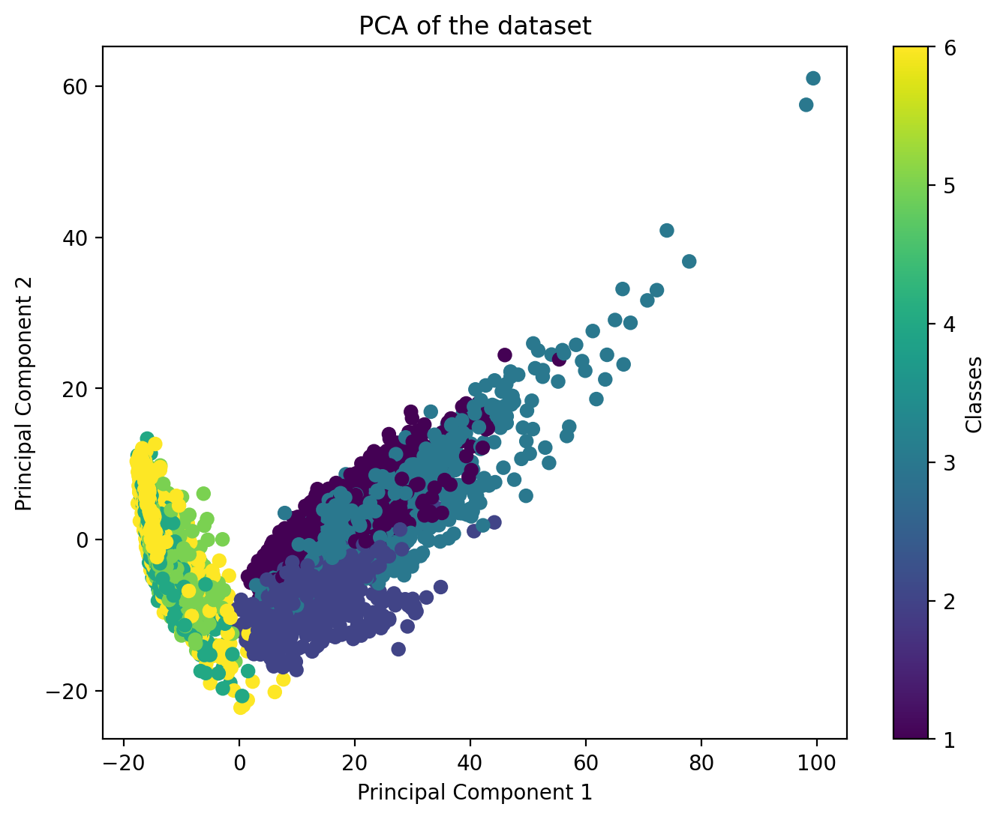

In [8]:
plt.figure(figsize=(8, 6))
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=y, cmap='viridis')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('PCA of the dataset')
plt.colorbar(label='Classes')
plt.show()

### Задание 1.4 (0.4 балла)

Сделайте кластеризацию данных методом ```KMeans```, обучив модель на данных со сниженной за счет ```PCA```
размерностью. В данном случае нужно искать 6 кластеров (изначально у нас 6 классов). Засеките время обучения и время инференса.

Параметры:

```n_clusters = 6``` (число уникальных меток целевого класса = 6)

```n_init = 100```

```random_state = RANDOM_STATE``` (для воспроизводимости результата, не забывайте указывать его и дальше!)

[Документация](https://scikit-learn.org/stable/modules/generated/sklearn.cluster.KMeans.html)

In [9]:
kmeans = KMeans(n_clusters=6, n_init=100, random_state=42)

In [10]:
with tqdm(desc="Обучение", total=1) as progress_bar:   
    kmeans.fit(X_pca)    
    progress_bar.update(1)

Обучение: 100%|██████████| 1/1 [00:14<00:00, 14.10s/it]


In [11]:
with tqdm(desc="Инференс", total=1) as progress_bar:   
    labels = kmeans.predict(X_pca)    
    progress_bar.update(1)

Инференс: 100%|██████████| 1/1 [00:00<00:00, 490.73it/s]


### Задание 1.5 (0.2 балла)

Визуализируйте данные в проекции на первые две главные компоненты. Раскрасьте точки в соответствии с полученными метками кластеров.

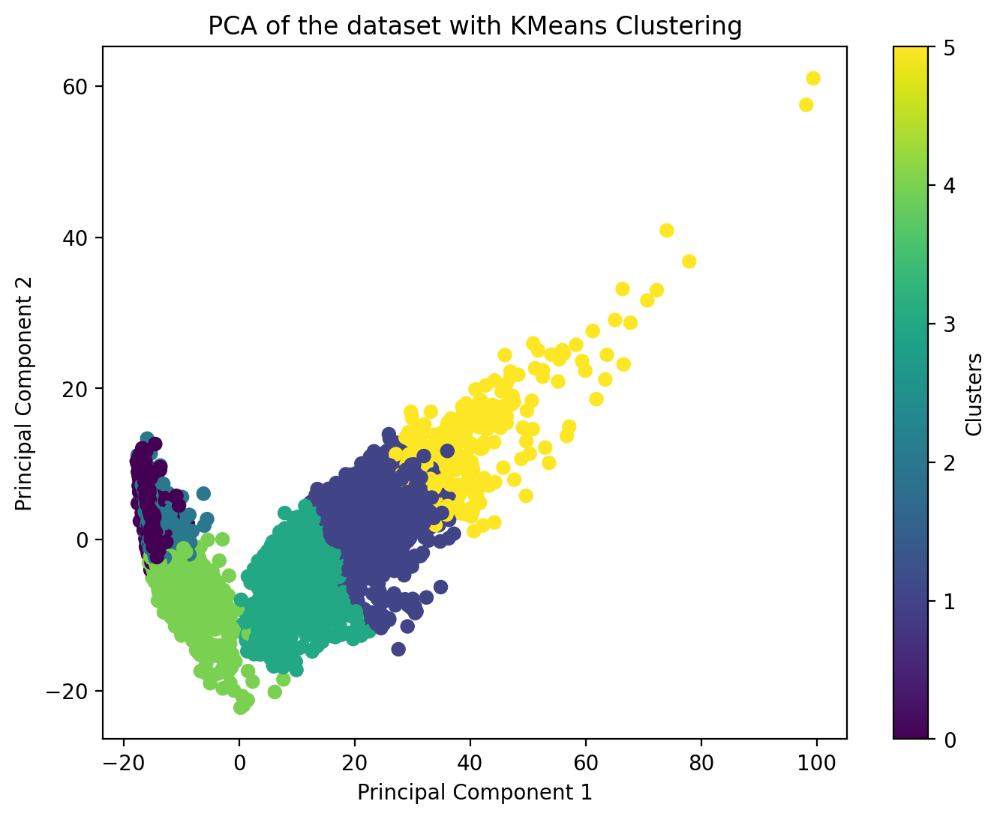

In [12]:
plt.figure(figsize=(8, 6))
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=labels, cmap='viridis')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('PCA of the dataset with KMeans Clustering')
plt.colorbar(label='Clusters')
plt.show()

### Задание 1.6 (0.3 баллов)

Выберите какие-то метрики (минимум две) из известных вам или из методички (ссылка в начале дз, пункт 2.3.10), объясните ваш выбор.

Выведите на экран значения метрик качества кластеризации и используйте их далее.

In [13]:
silhouette = metrics.silhouette_score(X_pca, labels)
print("Silhouette Score:", silhouette)

ari = metrics.adjusted_rand_score(y, labels)
print("Adjusted Rand Index:", ari)

v_measure = metrics.v_measure_score(y, labels)
print("V-measure:", v_measure)

Silhouette Score: 0.1414975946758147
Adjusted Rand Index: 0.4194956465790897
V-measure: 0.5600410921019029


Я решил использовать две метрики:
- Silhouette Coefficient
 является мерой компактности кластеров и разделенности между кластерами. метрика ограничена от -1 для неправильной кластеризации до +1 для очень плотной кластеризации. Оценки около нуля указывают на перекрывающиеся кластеры.
- ARI измеряет сходство между двумя различными разметками данных, такими как истинные метки классов и метки, предсказанные алгоритмом кластеризации
- V-measure показывает гармоническое среднее между гомогенностью и полнотой кластеризации.

 Эти три метрики выбраны, потому что они предоставляют информацию о качестве кластеризации, но с разных точек зрения. Silhouette Score измеряет внутрикластерное сходство и межкластерное различие, тогда как ARI измеряет сходство между фактическими метками и предсказанными метками кластеров.


### Задание 1.7 (0.8 баллов)
Теперь попробуем сделать кластеризацию с помощью ```AgglomerativeClustering```.

Вновь визуализируйте данные с раскраской по полученным меткам и выведите метрики. Засеките время обучения и время инференса. Сравните с ```KMeans```.

Ответьте на следующие вопросы:
* Стало ли лучше?
* Почему?

[Документация](https://scikit-learn.org/stable/modules/generated/sklearn.cluster.AgglomerativeClustering.html)

In [14]:
from sklearn.cluster import AgglomerativeClustering

ag = AgglomerativeClustering(n_clusters=6)

In [15]:
with tqdm(desc="Обучение", total=1) as progress_bar:    
    ag.fit(X_pca)   
    progress_bar.update(1)

Обучение: 100%|██████████| 1/1 [00:02<00:00,  2.98s/it]


In [16]:
with tqdm(desc="Инференс", total=1) as progress_bar:    
    ag_labels = ag.fit_predict(X_pca)   
    progress_bar.update(1)

Инференс: 100%|██████████| 1/1 [00:03<00:00,  3.02s/it]


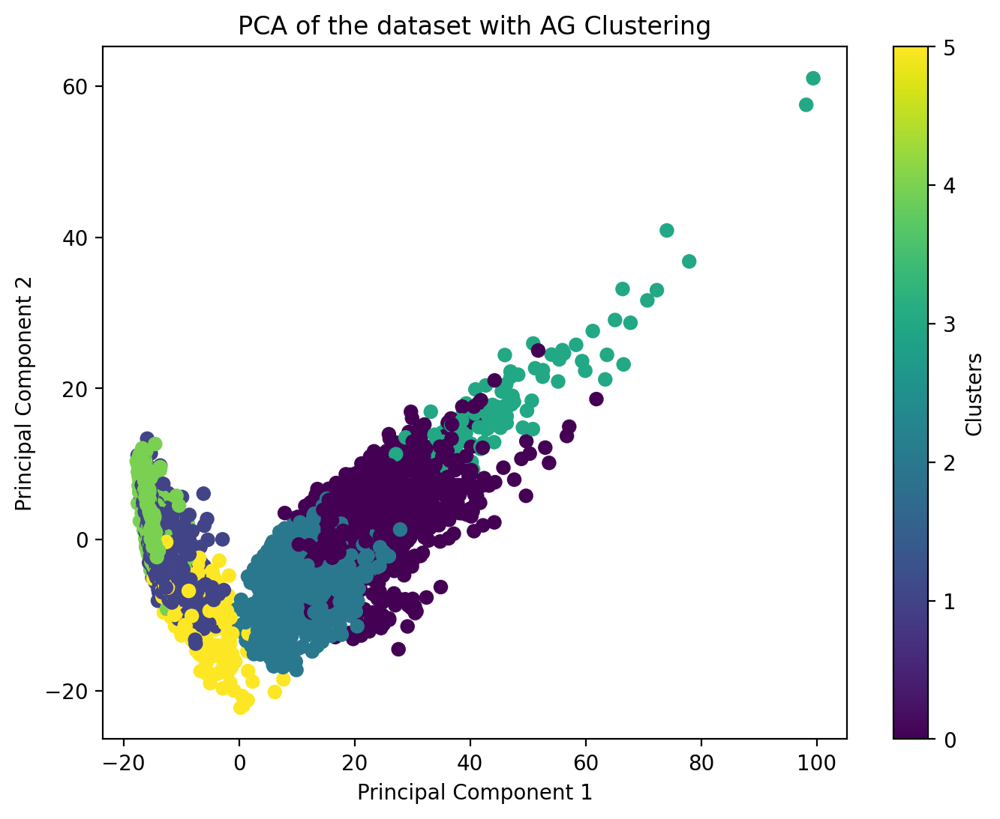

In [17]:
plt.figure(figsize=(8, 6))
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=ag_labels, cmap='viridis')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('PCA of the dataset with AG Clustering')
plt.colorbar(label='Clusters')
plt.show()

In [18]:
silhouette = metrics.silhouette_score(X_pca, ag_labels)
print("Silhouette Score:", silhouette)

ari = metrics.adjusted_rand_score(y, ag_labels)
print("Adjusted Rand Index:", ari)

v_measure = metrics.v_measure_score(y, ag_labels)
print("V-measure:", v_measure)


Silhouette Score: 0.13658179879624438
Adjusted Rand Index: 0.49362763373004886
V-measure: 0.6217855076000528


Предсказания стали слегка точнее, но даже по графику стало заметнее, что кластеры стали слегка сильнее перекрываться

### Задание 1.8 (0.8 баллов)

Попробуйте применить другие методы кластеризации из sklearn.  Засеките время обучения и время инференса. Также вычислите метрики качества, визуализируйте результаты, после чего сделайте вывод о том, какой метод сработал лучше.

In [19]:
from sklearn.mixture import GaussianMixture

gmm = GaussianMixture(n_components=6, random_state=42)

In [20]:
with tqdm(desc="Обучение", total=1) as progress_bar:   
    gmm.fit(X_pca)    
    progress_bar.update(1)

Обучение: 100%|██████████| 1/1 [00:04<00:00,  4.49s/it]


In [21]:
with tqdm(desc="Инференс", total=1) as progress_bar:    
    gmm_labels = gmm.fit_predict(X_pca)    
    progress_bar.update(1)

Инференс: 100%|██████████| 1/1 [00:05<00:00,  5.09s/it]


In [22]:
silhouette = metrics.silhouette_score(X_pca, gmm_labels)
print("Silhouette Score:", silhouette)

ari = metrics.adjusted_rand_score(y, gmm_labels)
print("Adjusted Rand Index:", ari)

v_measure = metrics.v_measure_score(y, gmm_labels)
print("V-measure:", v_measure)

Silhouette Score: 0.13547530344322584
Adjusted Rand Index: 0.32960440967450816
V-measure: 0.5002632970425919


In [23]:
from sklearn.cluster import MeanShift

mean_shift = MeanShift()


In [24]:
with tqdm(desc="Обучение", total=1) as progress_bar:    
    mean_shift.fit(X_pca)        
    progress_bar.update(1)

Обучение: 100%|██████████| 1/1 [00:52<00:00, 52.07s/it]


In [25]:
with tqdm(desc="Инференс", total=1) as progress_bar:    
    mean_shift_labels = mean_shift.fit_predict(X_pca)    
    progress_bar.update(1)

Инференс: 100%|██████████| 1/1 [00:49<00:00, 49.96s/it]


In [26]:
silhouette = metrics.silhouette_score(X_pca, mean_shift_labels)
print("Silhouette Score:", silhouette)

ari = metrics.adjusted_rand_score(y, mean_shift_labels)
print("Adjusted Rand Index:", ari)

v_measure = metrics.v_measure_score(y, mean_shift_labels)
print("V-measure:", v_measure)

Silhouette Score: 0.3361630262412112
Adjusted Rand Index: 0.32497745820622465
V-measure: 0.5145474682063665


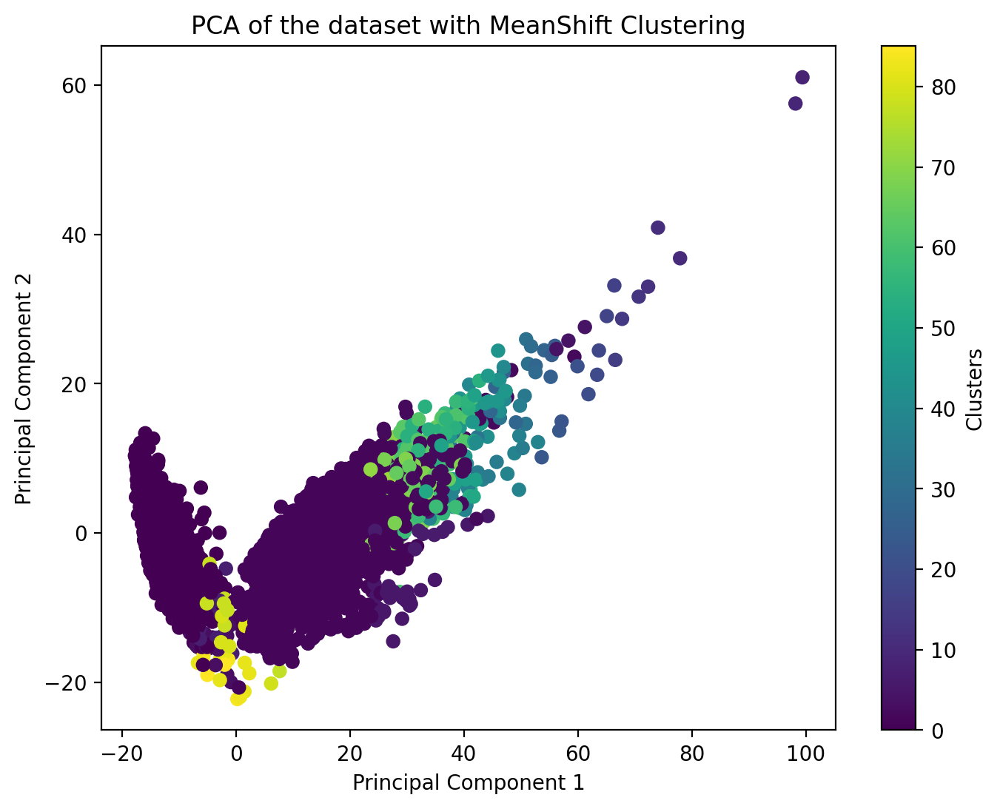

In [27]:
plt.figure(figsize=(8, 6))
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=mean_shift_labels, cmap='viridis')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('PCA of the dataset with MeanShift Clustering')
plt.colorbar(label='Clusters')
plt.show()

In [28]:
from sklearn.cluster import MiniBatchKMeans

mini_batch_kmeans = MiniBatchKMeans(n_clusters=6, n_init=200, random_state=RANDOM_STATE)

In [29]:
with tqdm(desc="Обучение", total=1) as progress_bar:    
    mini_batch_kmeans.fit(X_pca)        
    progress_bar.update(1)

Обучение: 100%|██████████| 1/1 [00:19<00:00, 19.86s/it]


In [30]:
with tqdm(desc="Инференс", total=1) as progress_bar:   
    mini_batch_kmeans_labels = mini_batch_kmeans.fit_predict(X_pca)    
    progress_bar.update(1)

Инференс: 100%|██████████| 1/1 [00:19<00:00, 19.34s/it]


In [31]:
silhouette = metrics.silhouette_score(X_pca, mini_batch_kmeans_labels)
print("Silhouette Score:", silhouette)

ari = metrics.adjusted_rand_score(y, mini_batch_kmeans_labels)
print("Adjusted Rand Index:", ari)

v_measure = metrics.v_measure_score(y, mini_batch_kmeans_labels)
print("V-measure:", v_measure)

Silhouette Score: 0.12724508019173367
Adjusted Rand Index: 0.28163515522410015
V-measure: 0.45115335020674147


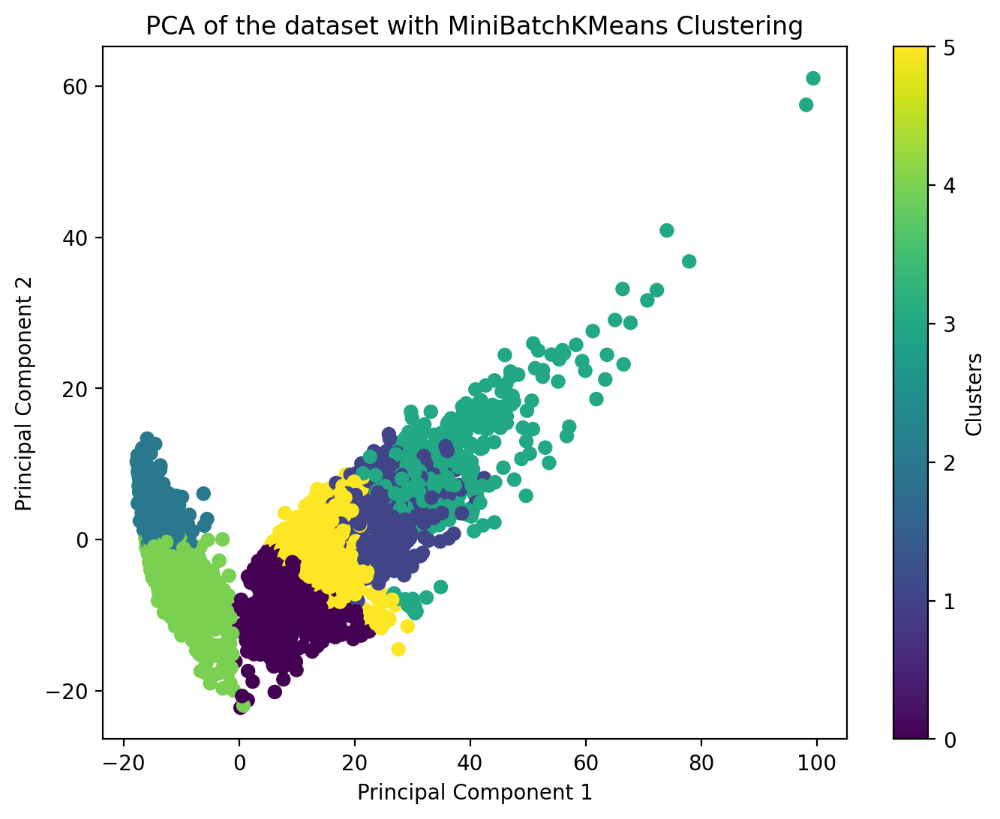

In [32]:
plt.figure(figsize=(8, 6))
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=mini_batch_kmeans_labels, cmap='viridis')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('PCA of the dataset with MiniBatchKMeans Clustering')
plt.colorbar(label='Clusters')
plt.show()

### Задание 1.9 (1 балл)
Для самой успешной из полученных кластеризаций попробуйте дать интерпретацию кластеров. Опишите характеристики объектов, попавших в каждый кластер. Для этого можете ответить на следующие вопросы:

* Похожи ли объекты внутри каждого кластера на определенный тип активности человека?
* В каких кластерах смешано несколько типов активности? С чем, на ваш взгляд, это может быть связано?
* Качественная ли получилась кластеризация? На основании чего вы можете сделать такой вывод?

1) В целом да, за исключением редких ошибок.
2) Во всех кластерах наблюдается смешание нескольких похожих типов активностей. Это связано с тем, что внешние условия далеки от чистоты лабораторного эксперемента и может быть тяжело определить по показаниям приборов что человек делает - поднимается по лестнице или идет в горку, он сидит, лежит или может полулежа развалился в кресле.
3) На основе показателя V-mesure делаю вывод, что кластеризация относительно "норм", но не идеальная и требует дальнейшей магии фич и тд.

In [33]:
tab = pd.crosstab(y, mini_batch_kmeans_labels, margins=True)
tab.index = ['ходьба', 'подъем вверх по лестнице', 'спуск по лестнице', 'сидение', 'стояние', 'лежание', 'итого']
tab.columns = ['cluster' + str(i + 1) for i in range(6)] + ['итого']
tab

,cluster1,cluster2,cluster3,cluster4,cluster5,cluster6,итого
ходьба,266,367,0,141,0,948,1722
подъем вверх по лестнице,1003,148,0,24,0,369,1544
спуск по лестнице,146,666,0,258,0,336,1406
сидение,3,0,1221,0,553,0,1777
стояние,1,0,1167,0,738,0,1906
лежание,13,0,1294,0,637,0,1944
итого,1432,1181,3682,423,1928,1653,10299


## Задание 2. Разделение изображения на семантические компоненты (5 баллов)

![RedPanda](http://imgur.com/6Aa52Lm.png)

Алгоритмы кластеризации могут применяться в самых разных задачах. Например, в анализе изображений есть задача разделения изображения на семантические компоненты, которую можно решать в том числе с помощью алгоритмов кластеризации. 

Проверим их на ```duck.jpg``` и ```owls.jpg```

### Задание 2.0 (0.1 балл)

Откройте изображения, после чего визуализируйте их с помощью ```plt.imshow()```

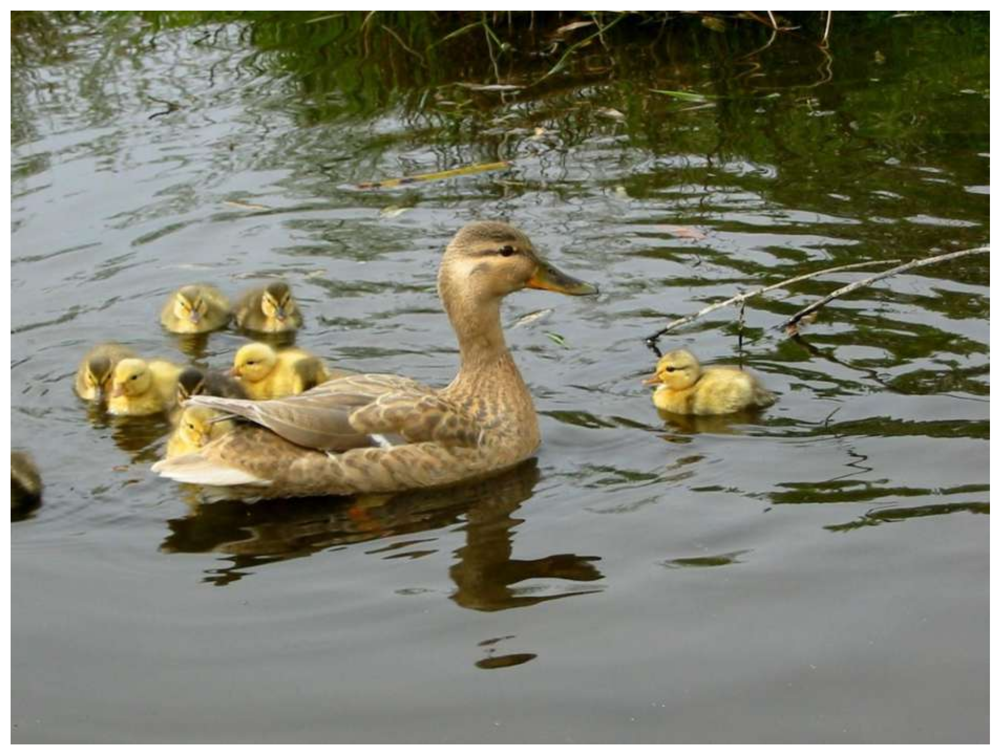

In [2]:
from PIL import Image

duck_image = np.array(Image.open('Duck.jpg'))
plt.axis('off')
plt.imshow(duck_image);

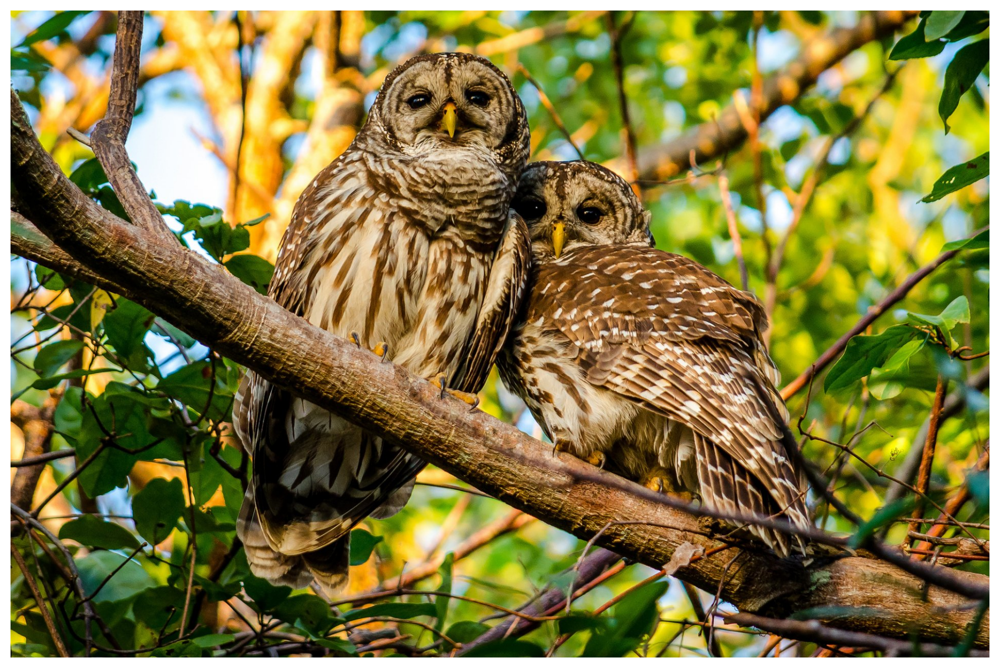

In [3]:
owls_image = np.array(Image.open('Owls.jpg'))
plt.axis('off')
plt.imshow(owls_image);

### Задание 2.1 (1.5 балла)
Для каждого изображения, используя кластеризацию ```KMeans```, выделите компоненты, охарактеризовав каждый пиксель следующим образом: $\psi_i = [\lambda x_i, \lambda y_i, r_i, g_i, b_i]$, где 
$x_i$ и $y_i$ — координаты пикселя, $r_i, g_i, b_i$ — его цвет, $\lambda$ — параметр, выражающий важность пространственной связности перед цветовой похожестью.

Примените полученную функцию, взяв следующие $\lambda$: 0.3 и 1.5 для ```duck.jpg``` и ```owls.jpg``` (или другие, но тогда с вас красивые результаты :) )

Число кластеров подберите разумным образом на свой вкус (в качестве нулевого приближения можно взять 3)

In [4]:
def find_components(image, lmbd, n_clusters):   
    
    width, height, _ = image.shape   
    
    data = []   
    
    coordinates = np.array([(lmbd * i, lmbd * j) for i in range(width) for j in range(height)])
    
    for i in range(width):
        for j in range(height):
            r, g, b = image[i][j]
            data.append([r, g, b])    
    
    data = np.array(data)    
    
    features = np.hstack((coordinates, data))    
    
    kmeans = KMeans(n_clusters=n_clusters, n_init=3, random_state=RANDOM_STATE)
    kmeans.fit(features)    

    return kmeans.labels_

In [5]:
import cv2
def find_components2(image):
    from skimage.filters import threshold_otsu
    from skimage.measure import label

    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    
    binary_image = gray_image > threshold_otsu(gray_image)
    
    binary_image = cv2.morphologyEx(binary_image.astype(np.uint8), cv2.MORPH_CLOSE, np.ones((5,5), np.uint8))

    binary_image = cv2.morphologyEx(binary_image, cv2.MORPH_CLOSE, np.ones((5, 5), np.uint8))

    binary_image = cv2.morphologyEx(binary_image, cv2.MORPH_CLOSE, np.ones((5, 5), np.uint8))

    labeled_image, _ = label(binary_image, connectivity=2, return_num=True)
    
    return labeled_image

In [5]:
def visualize_segmentation(image, labels):  
    labels_ = np.reshape(labels, (image.shape[0], image.shape[1]))  

    n_clusters = len(np.unique(labels))

    for l in range(n_clusters):
        plt.contour(labels_ == l, colors=[plt.cm.nipy_spectral(l / float(n_clusters))], linewidths=2)

    plt.axis('off')
    plt.imshow(image)
    plt.show()

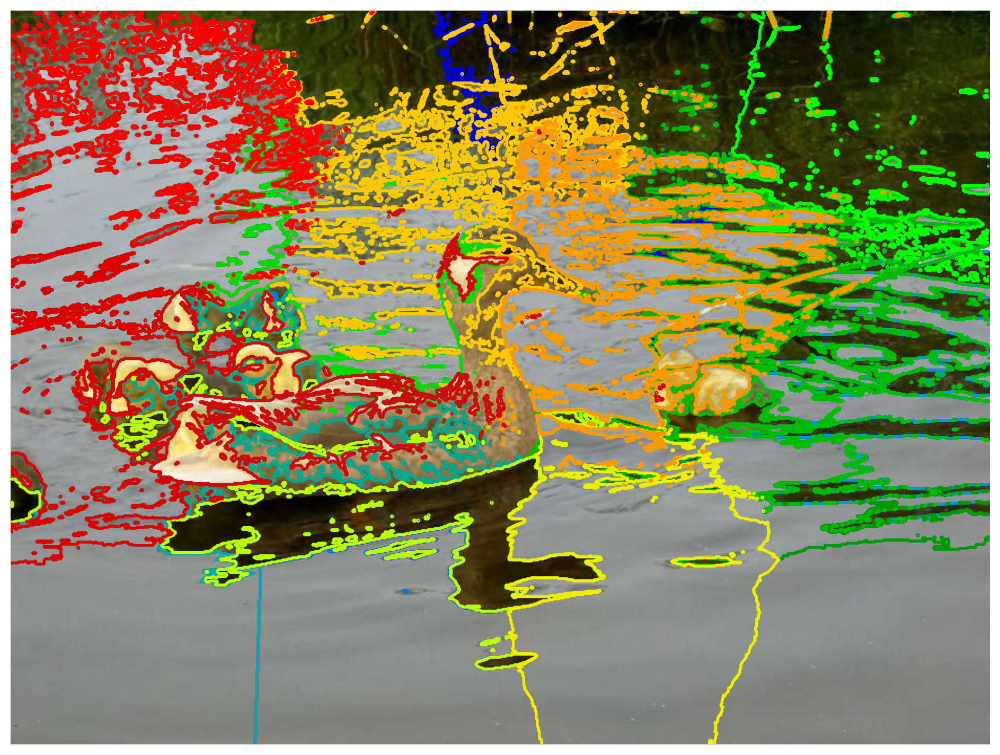

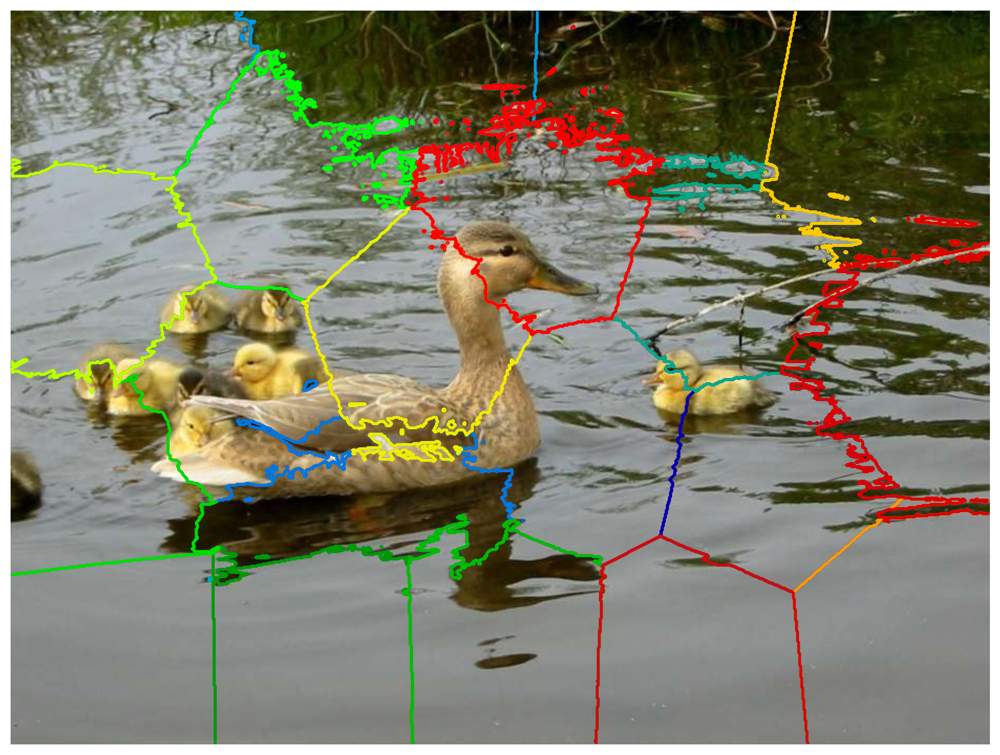

In [6]:
for lmbd in [0.3, 1.5]:
    duck_labels = find_components(duck_image, lmbd, 20)
    visualize_segmentation(duck_image, duck_labels)

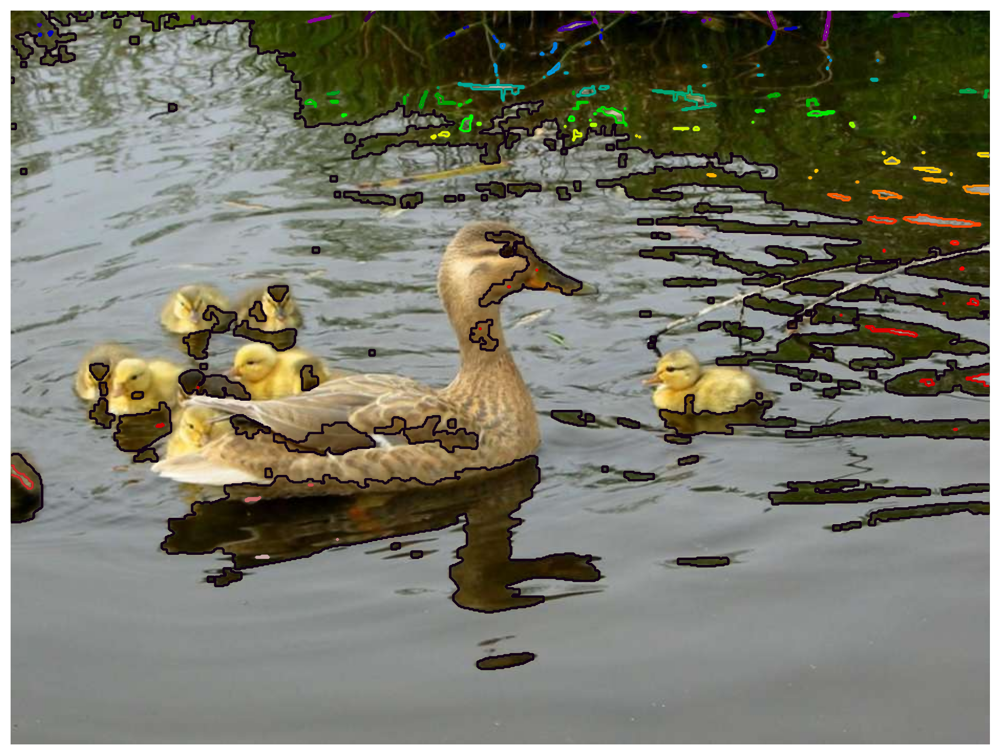

In [41]:
duck_labels = find_components2(duck_image)
visualize_segmentation(duck_image, duck_labels)

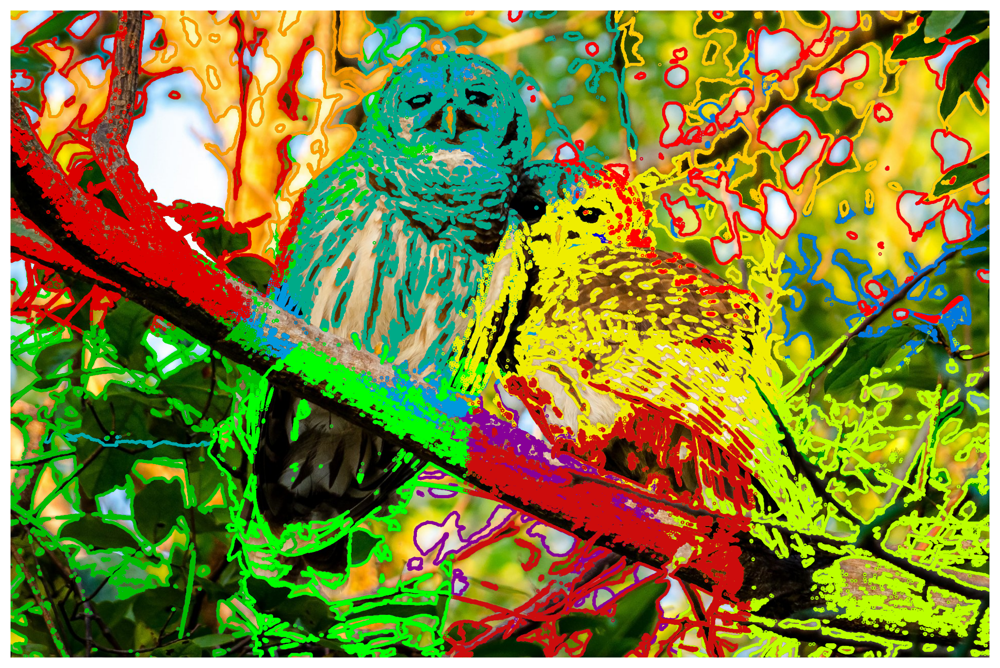

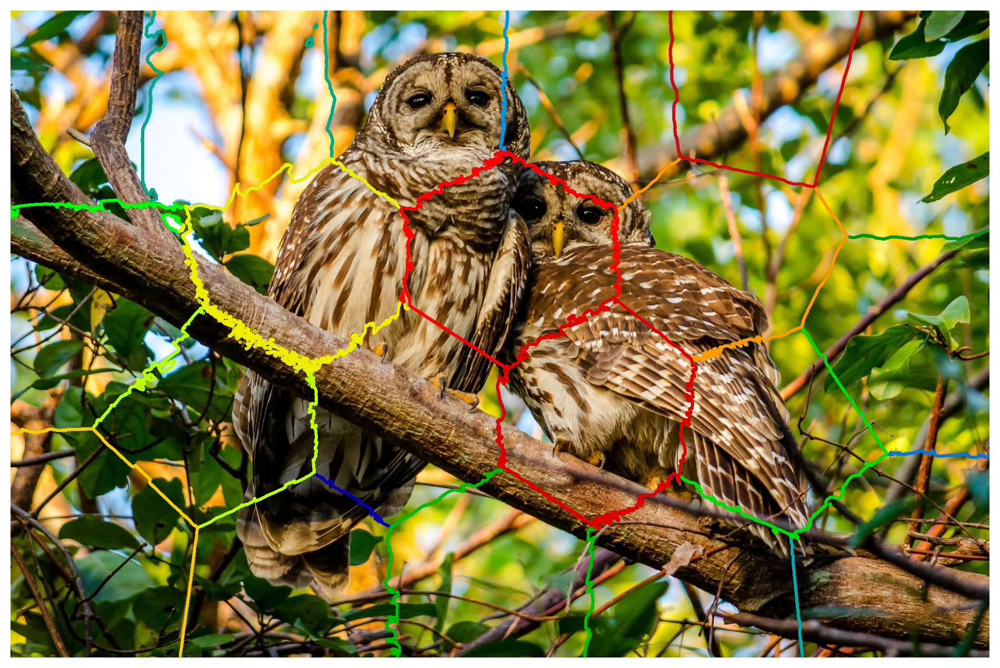

In [7]:
for lmbd in [0.3, 1.5]:
    duck_labels = find_components(owls_image, lmbd, 20)
    visualize_segmentation(owls_image, duck_labels)

### Задание 2.2 (1.5 балла)
Попробуйте выделить сегменты при помощи [спектральной кластеризации](http://scikit-learn.org/stable/modules/clustering.html#spectral-clustering). Обратите внимание на [пример в sklearn](http://scikit-learn.org/0.16/auto_examples/cluster/plot_lena_segmentation.html). Для ускорения работы алгоритма рекомендуется привести изображение к серому цвету. При необходимости можно сжать изображения в 2 раза.

Подсказка: ```skimage``` с его ```color``` и ```transform``` в этом помогут :)

Или же воспользуйтесь аналогичными средствами ```PIL``` или ```cv2``` 

In [8]:
from skimage.color import rgb2gray
from skimage.transform import rescale
from sklearn.feature_extraction import image
from sklearn.cluster import spectral_clustering

def spectral_segmentation(image_input, clusters, beta=5, eps=1e-6):
    # Преобразование в оттенки серого
    grayscale_image = rgb2gray(image_input)
    
    # Уменьшение размера изображения
    rescaled_image = rescale(grayscale_image, 0.5)
    
    # Создание графа и обработка данных
    graph = image.img_to_graph(rescaled_image)
    graph.data = np.exp(-beta * graph.data / rescaled_image.std()) + eps

    # Кластеризация
    labels_kmeans = spectral_clustering(graph, 
                                        n_clusters=clusters,
                                        assign_labels='kmeans',
                                        eigen_solver='amg',
                                        random_state=RANDOM_STATE)
    labels_discretize = spectral_clustering(graph, 
                                            n_clusters=clusters,
                                            assign_labels='discretize',
                                            eigen_solver='amg',
                                            random_state=RANDOM_STATE)
    
    # Визуализация
    plt.figure(figsize=(14, 7))
    
    plt.subplot(1, 2, 1)
    plt.imshow(rescaled_image, cmap=plt.cm.gray)
    for l in range(clusters):
        plt.contour(labels_kmeans.reshape(rescaled_image.shape) == l, colors=[plt.cm.nipy_spectral(l / clusters)])
    plt.axis('off')
    plt.title('Spectral clustering: kmeans')

    plt.subplot(1, 2, 2)
    plt.imshow(rescaled_image, cmap=plt.cm.gray)
    for l in range(clusters):
        plt.contour(labels_discretize.reshape(rescaled_image.shape) == l, colors=[plt.cm.nipy_spectral(l / clusters)])
    plt.axis('off')
    plt.title('Spectral clustering: discretize')

    plt.show()

### Задание 2.3 (0.9 баллов)
Визуализируйте результаты сегментации (аналогично рисунку в начале задания 2) для обоих методов.

/home/choosen-one/.local/lib/python3.10/site-packages/sklearn/manifold/_spectral_embedding.py:393: UserWarning: Exited at iteration 8 with accuracies 
[3.02341487e-16 1.19205091e-03 1.20521351e-03 1.29035895e-03
 1.84365431e-03 1.04549919e-03 1.38576718e-03 1.52297140e-03
 1.17602857e-03 1.20105647e-03 1.71843356e-03 1.00229414e-03
 1.41582623e-03 1.32706207e-03 1.70489824e-03 1.89209068e-03
 1.45128046e-03 1.72811998e-03 1.67104412e-03 1.65551741e-03
 1.21248112e-03 1.48216824e-03 1.78695421e-03 1.55019797e-03
 1.94693506e-03 1.68570915e-03 1.63871295e-03 1.66241266e-03
 1.81637769e-03 1.42547243e-03 1.56465502e-03 1.72473346e-03
 1.58802322e-03 1.83306361e-03 1.96969598e-03 1.80618164e-03
 1.66291062e-03 1.32343305e-03 1.74229503e-03 1.59413708e-03
 1.26397819e-03 1.57272404e-03 1.24483815e-03 1.40510917e-03
 2.05350971e-03 1.36923000e-03 1.33214772e-03 1.39436172e-03
 1.76429287e-03 2.21876475e-03 1.44869977e-03 1.35092943e-03
 1.63488487e-03 1.28748692e-03 1.49848142e-03 1.52391991

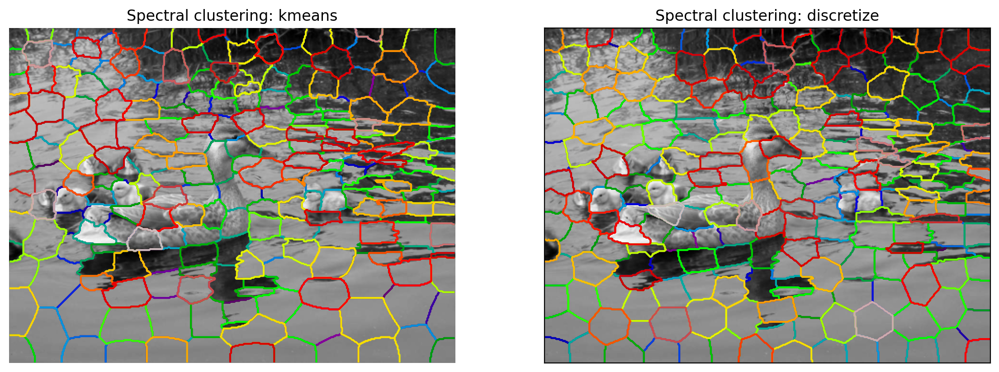

In [ ]:
spectral_segmentation(duck_image, 240)

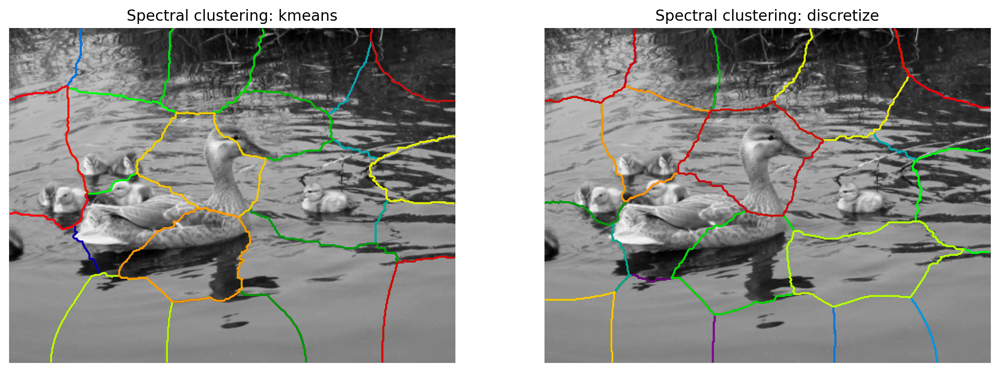

In [9]:
spectral_segmentation(duck_image, 20)

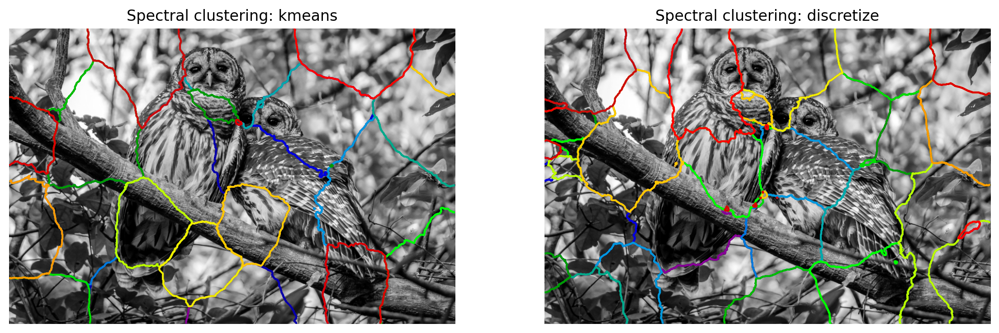

In [10]:
spectral_segmentation(owls_image, 20)

### Задание 2.4 (1 балл)
Найдите интересную картинку милого животного и примените алгоритмы и к ней. Поэкспериментируйте с параметрами алгоритмов. Картинку нужно будет загрузить вместе с работой. Слишком большие лучше не брать - считаться будет долго. Не забудьте визуализировать!

Сравните два подхода и сегментации, к которым они приводят.
Для всех ли изображений в результате сегментации хорошо видны контуры объектов?

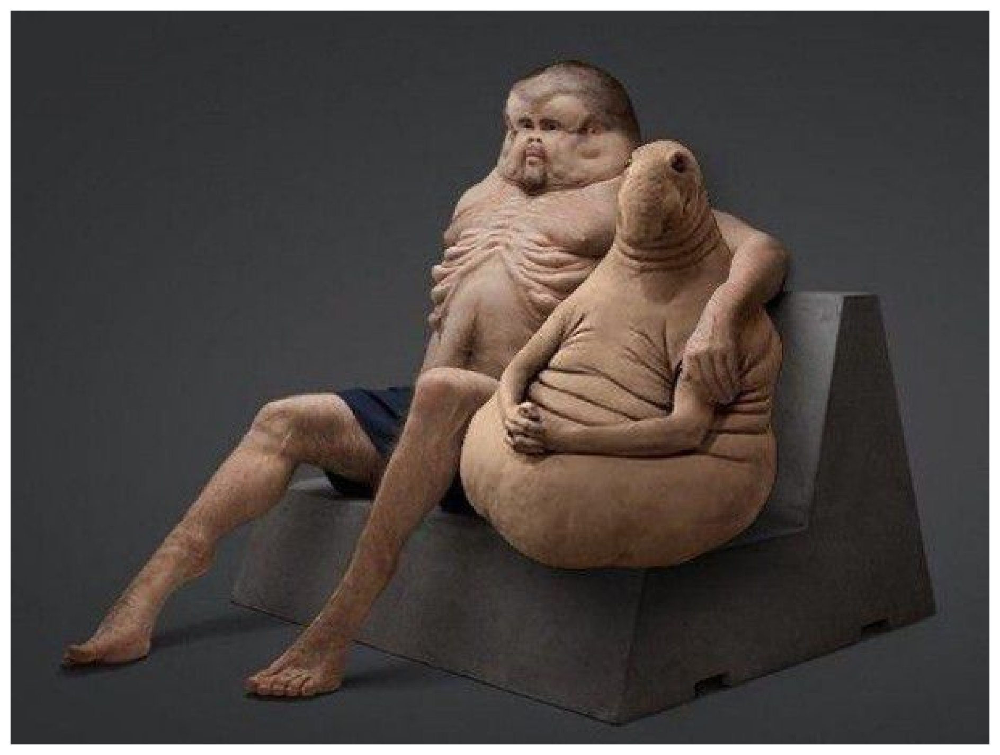

In [ ]:
together = np.array(Image.open('17.jpg'))
plt.axis('off')
plt.imshow(together);
# один ночью делает, второй проверяет

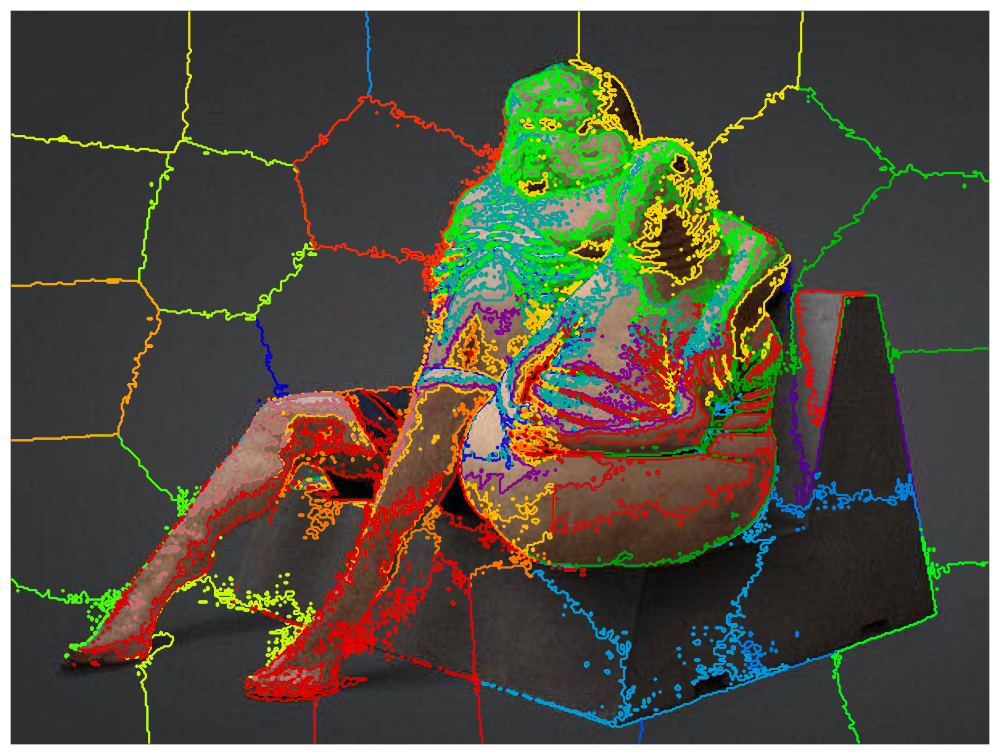

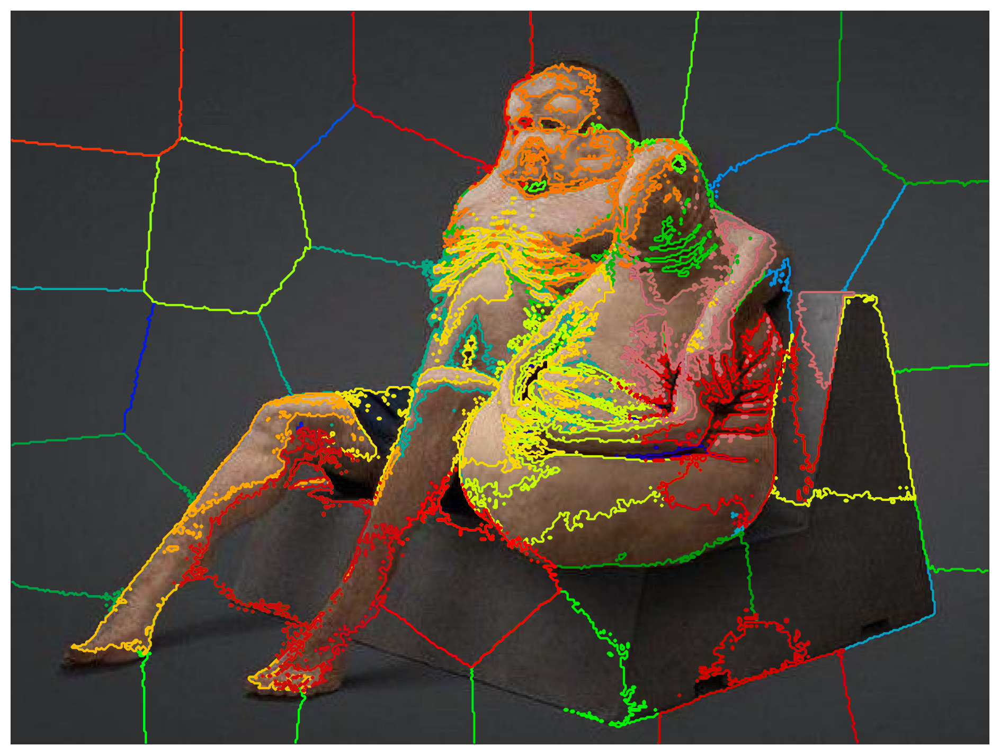

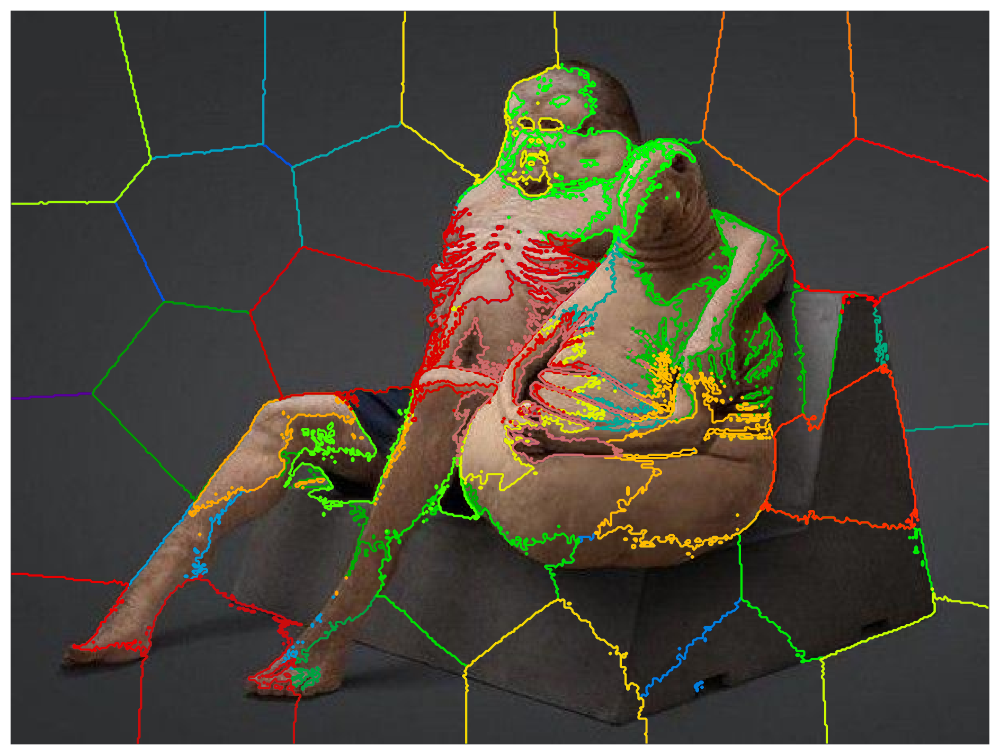

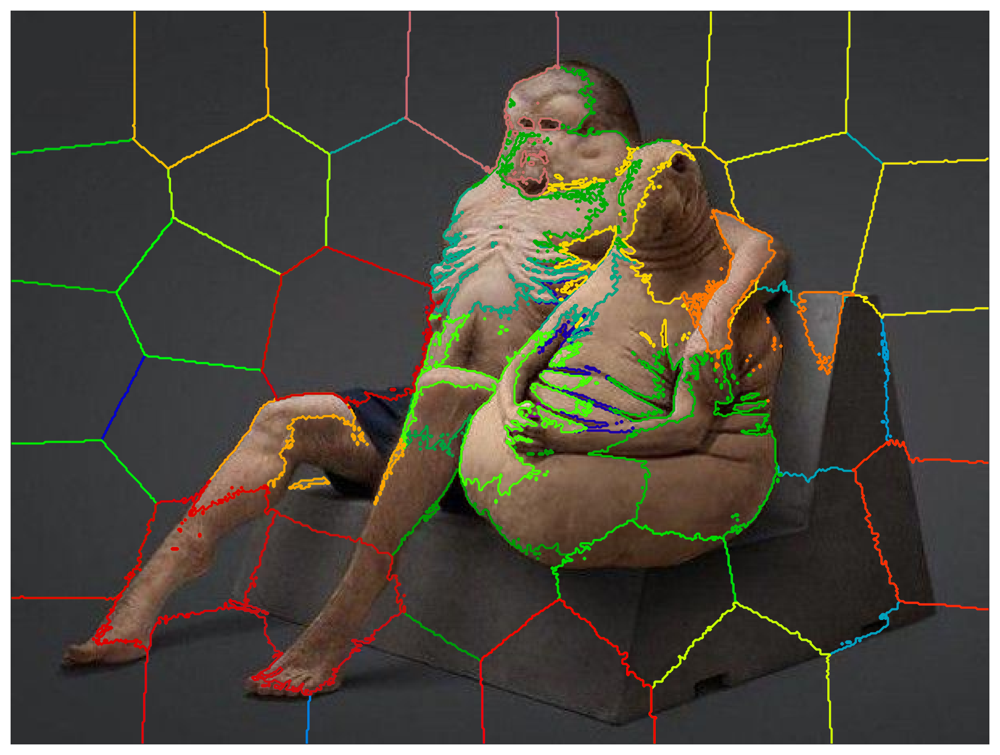

In [ ]:
for lmbd in np.arange(0.3, 1.5, 0.3):
    labels = find_components(together, lmbd, 42)
    visualize_segmentation(together, labels)

/home/choosen-one/.local/lib/python3.10/site-packages/sklearn/manifold/_spectral_embedding.py:393: UserWarning: Exited at iteration 15 with accuracies 
[2.78136925e-16 3.40907181e-04 4.67684490e-04 4.37794415e-04
 6.82645648e-04 3.94715972e-04 6.80420357e-04 5.28026795e-04
 3.16894015e-04 3.19288535e-04 3.99080216e-04 4.71265925e-04
 4.66878058e-04 5.07143079e-04 5.48660496e-04 4.17545438e-04
 4.83029658e-04 3.73355752e-04 5.23467553e-04 3.63866085e-04
 3.45473919e-04 5.72298911e-04 3.33443041e-04 3.35629711e-04
 6.43303739e-04 3.64804474e-04 5.50192442e-04 3.80004671e-04
 5.66525063e-04 6.19957649e-04 1.15026877e-03 4.27382025e-04
 3.95610051e-04 3.39662189e-04 4.39364843e-04 5.44345863e-04
 6.67216807e-04 7.26810603e-04 1.09743370e-03 5.08038024e-04
 7.89149470e-04 4.97492327e-04 8.56597267e-04 6.72623956e-04
 3.10209661e-04 7.12250149e-04 7.93517057e-04 1.10115047e-03
 6.14448225e-04 4.56210678e-04 1.60996834e-03 1.12634287e-03
 9.04798072e-04 3.24123755e-04 6.82843673e-04 7.6746119

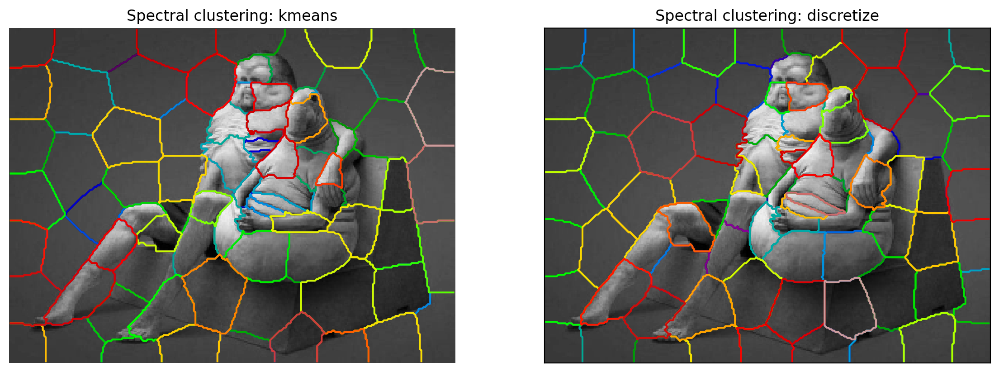

In [ ]:
spectral_segmentation(together, 82)

Сравните два подхода и сегментации, к которым они приводят.
Для всех ли изображений в результате сегментации хорошо видны контуры объектов?

Кажется, что на изображениях низкого качества и с урезанным количеством фич кластеризация работает хуже((с) КЭП). Насколько я понимаю - это подход лоб в лоб без малейшей хитрости и фича-инженеринга. Возможно он будет лучше работать на объектах с лучшей "контрастностью"(незнаю как назвать - насыщенностью/яркостью) между элементами. В целом, элементы напротив фона и мебели по контуру определили хорошо. 